In [24]:
from osgeo import gdal
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl


In [23]:
# Specify the path to your downloaded image
#image_path = 'D:\\owd1\\Documents\\GitHub-REPO\\Senior-project\\Docs\\Row_Data\\makkah_ALL_BANDS\\Sentinel2_Full_Image_AOI_Float.tif'

image_path = 'D:\\owd1\\Documents\\GitHub-REPO\Senior-project\\Docs\Row_Data\\UJ-2018-2024\\University-Of-Jeddah\\UJ-2_2018-12-25.tif'


In [25]:
# Open the image
ds = gdal.Open(image_path)


In [26]:
# Get raster size
x_size = ds.RasterXSize
y_size = ds.RasterYSize
print(f"Size: {x_size} x {y_size}")


Size: 370 x 321


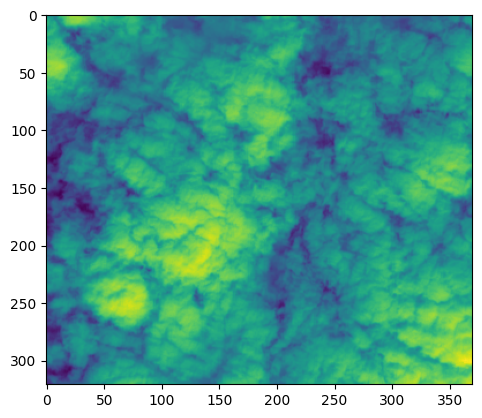

In [27]:
band = ds.GetRasterBand(2)
array = band.ReadAsArray()
plt.figure()
plt.imshow(array)

In [19]:
num_bands = ds.RasterCount
num_bands

23

IndexError: index 16 is out of bounds for axis 0 with size 16

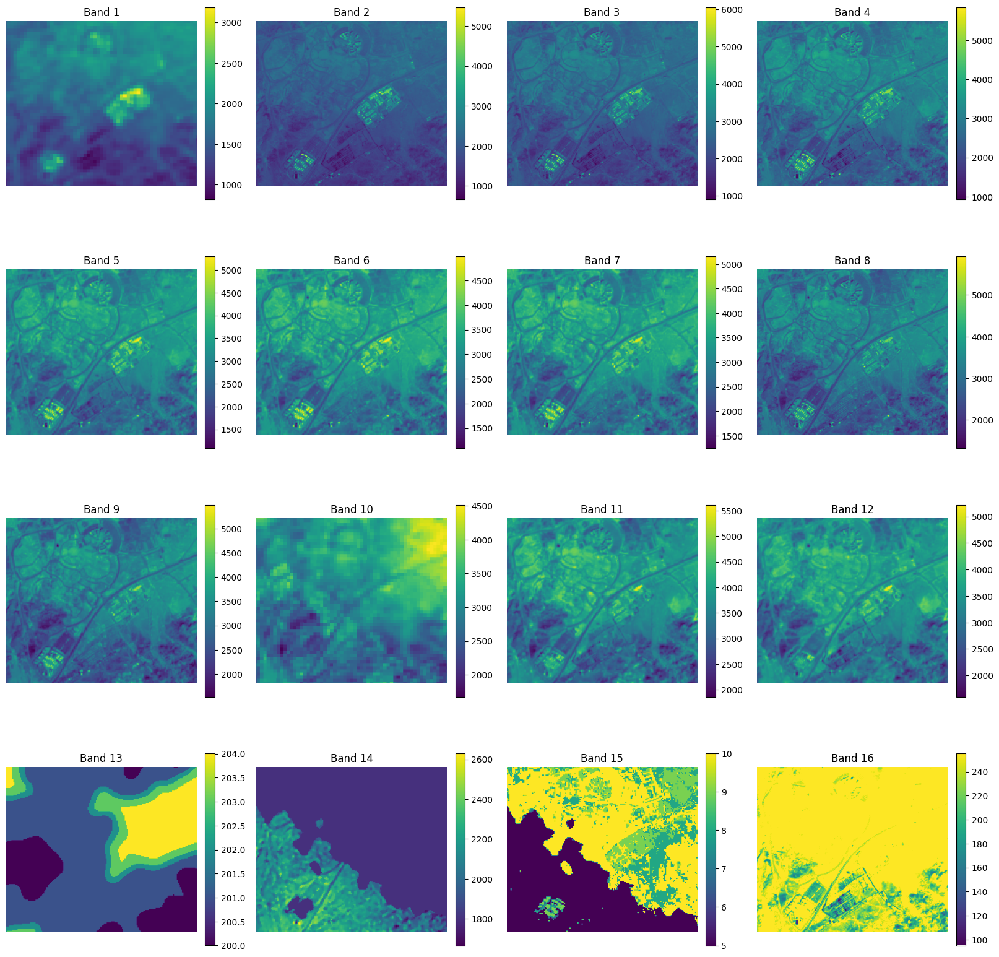

In [20]:
# Set up the plot
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20, 20))  # Adjust the size as needed
axes = axes.flatten()  # Flatten the 2D array of axes for easy iteration

for i in range(num_bands):
    band = ds.GetRasterBand(i + 1)  # Bands are 1-indexed in GDAL
    array = band.ReadAsArray()

    ax = axes[i]
    im = ax.imshow(array)
    ax.set_title(f'Band {i + 1}')
    ax.axis('off')

    # Optionally, you can add a colorbar for each subplot
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

plt.tight_layout()
plt.show()

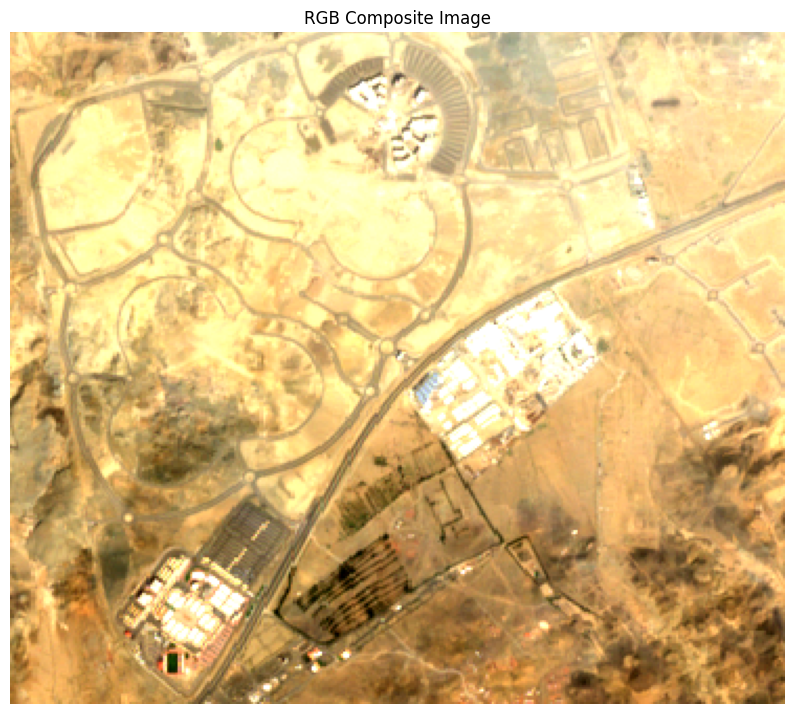

In [21]:
# Function to normalize array based on a given min and max value for display
def manual_normalize(array, min_val, max_val):
    array = np.clip(array, min_val, max_val)  # Clip to the specified range
    return (array - min_val) / (max_val - min_val)  # Normalize to [0, 1]

# Get bands for Red, Green, and Blue
band_red = ds.GetRasterBand(4).ReadAsArray()
band_green = ds.GetRasterBand(3).ReadAsArray()
band_blue = ds.GetRasterBand(2).ReadAsArray()

# Manually set the min and max values for display range based on histogram inspection or domain knowledge
min_display_val = 1000  # Example value, adjust based on your data
max_display_val = 3000  # Example value, adjust based on your data

# Normalize bands with the manually set display range
n_band_red = manual_normalize(band_red, min_display_val, max_display_val)
n_band_green = manual_normalize(band_green, min_display_val, max_display_val)
n_band_blue = manual_normalize(band_blue, min_display_val, max_display_val)

# Stack bands
rgb = np.dstack((n_band_red, n_band_green, n_band_blue))

# Plotting
plt.figure(figsize=(10, 10))
plt.imshow(rgb)
plt.title('RGB Composite Image')
plt.axis('off')  # Turn off the axis
plt.show()

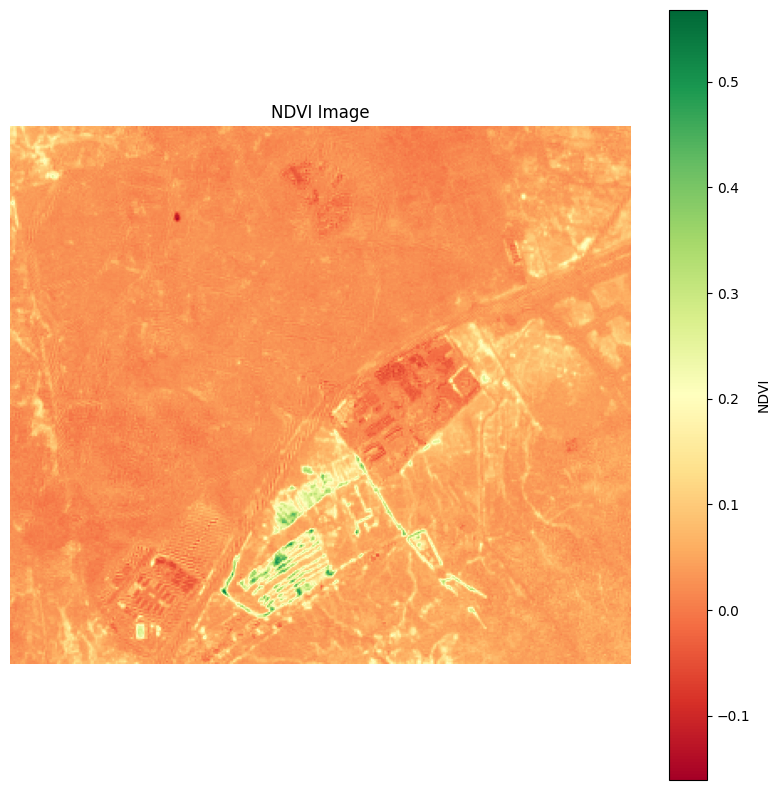

In [22]:
def read_band(band_number):
    band = ds.GetRasterBand(band_number).ReadAsArray().astype(np.float32)
    return band

# Read the Red and NIR bands from the dataset
red = read_band(4)  # Assuming Band 4 is Red
nir = read_band(8)  # Assuming Band 8 is NIR

# Calculate NDVI
ndvi = (nir - red) / (nir + red)


# Plot NDVI
plt.figure(figsize=(10, 10))
plt.imshow(ndvi, cmap='RdYlGn')
plt.colorbar(label='NDVI')
plt.title('NDVI Image')
plt.axis('off')  # Turn off the axis
plt.show()

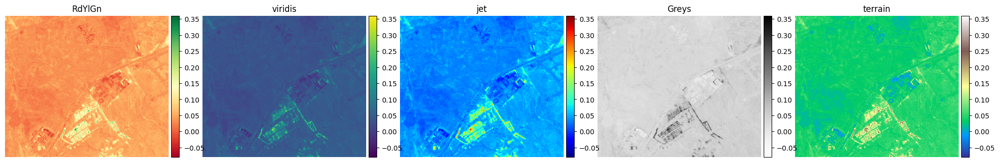

In [19]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def read_band(band_number):
    """Read a specific band from the dataset."""
    band = ds.GetRasterBand(band_number).ReadAsArray().astype(np.float32)
    return band

# Assuming Band 4 is Red and Band 5 (or another) is NIR
# Update band numbers according to your dataset's specific band ordering
red = read_band(4)  # Update the band number for Red
nir = read_band(8)  # Update the band number for NIR

# Calculate NDVI
ndvi = (nir - red) / (nir + red)

# Define colormaps to use
colormaps = ['RdYlGn', 'viridis', 'jet', 'Greys', 'terrain']

# Create a figure with 5 subplots for each colormap
fig, axes = plt.subplots(1, 5, figsize=(20, 8))

# Plot NDVI with each colormap
for ax, cmap in zip(axes, colormaps):
    im = ax.imshow(ndvi, cmap=cmap)
    ax.set_title(cmap)
    ax.axis('off')  # Remove axis ticks and labels

    # Add a colorbar to each subplot
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax)

plt.tight_layout()
plt.show()

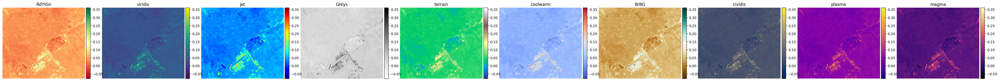

In [20]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Add 5 more colormaps to the existing list
colormaps.extend(['coolwarm', 'BrBG', 'cividis', 'plasma', 'magma'])

# Create a figure with 10 subplots (5 existing + 5 new) for each colormap
fig, axes = plt.subplots(1, 10, figsize=(40, 4))  # Adjusted for 10 subplots

# Plot NDVI with each colormap
for ax, cmap in zip(axes, colormaps):
    im = ax.imshow(ndvi, cmap=cmap)
    ax.set_title(cmap)
    ax.axis('off')  # Remove axis ticks and labels

    # Add a colorbar to each subplot
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax)

plt.tight_layout()
plt.show()


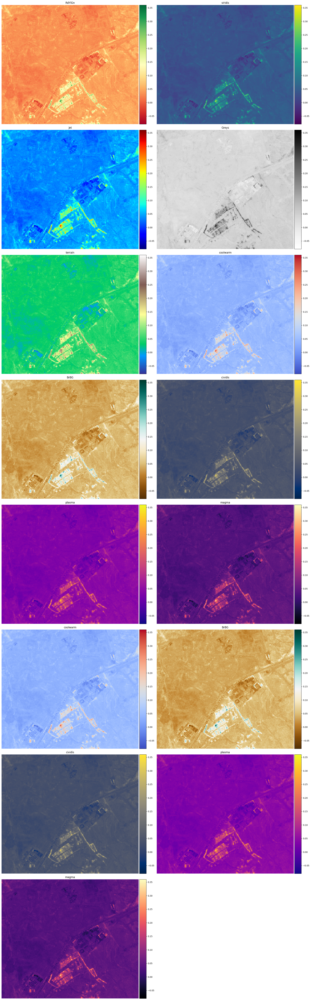

In [21]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Extend the original colormaps list with 5 more colormaps
colormaps.extend(['coolwarm', 'BrBG', 'cividis', 'plasma', 'magma'])

# Number of colormaps dictates the number of subplots
n_colormaps = len(colormaps)
n_cols = 2  # Number of columns per row
n_rows = n_colormaps // n_cols + (n_colormaps % n_cols > 0)  # Calculate the required number of rows

# Create a figure with the calculated number of subplots (rows and columns)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(10 * n_cols, 8 * n_rows))

# Flatten the axes array for easy iteration if it's 2D (which it will be if there's more than one row)
axes = axes.flatten()

# Plot NDVI with each colormap
for ax, cmap in zip(axes, colormaps):
    im = ax.imshow(ndvi, cmap=cmap)
    ax.set_title(cmap)
    ax.axis('off')  # Remove axis ticks and labels

    # Add a colorbar to each subplot
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax)

# Hide any unused subplots if the number of colormaps isn't a perfect multiple of the number of columns
for i in range(n_colormaps, n_rows * n_cols):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

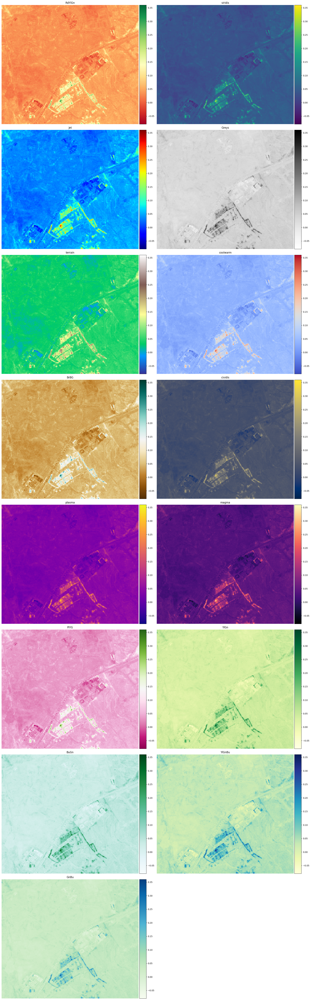

In [22]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.pyplot as plt

# Starting list of colormaps
colormaps = ['RdYlGn', 'viridis', 'jet', 'Greys', 'terrain']

# Extend the original colormaps list with 5 more colormaps suitable for NDVI visualization
colormaps.extend(['coolwarm', 'BrBG', 'cividis', 'plasma', 'magma', 'PiYG', 'YlGn', 'BuGn', 'YlGnBu', 'GnBu'])

# Number of colormaps dictates the number of subplots
n_colormaps = len(colormaps)
n_cols = 2  # Number of columns per row
n_rows = n_colormaps // n_cols + (n_colormaps % n_cols > 0)  # Calculate the required number of rows

# Create a figure with the calculated number of subplots (rows and columns)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(10 * n_cols, 8 * n_rows))

# Flatten the axes array for easy iteration if it's 2D (which it will be if there's more than one row)
axes = axes.flatten()

# Plot NDVI with each colormap
for ax, cmap in zip(axes, colormaps):
    im = ax.imshow(ndvi, cmap=cmap)
    ax.set_title(cmap)
    ax.axis('off')  # Remove axis ticks and labels

    # Add a colorbar to each subplot
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax)

# Hide any unused subplots if the number of colormaps isn't a perfect multiple of the number of columns
for i in range(n_colormaps, n_rows * n_cols):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


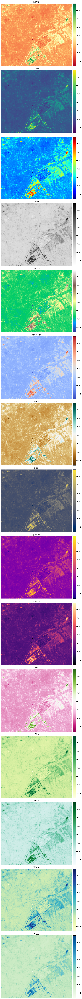

In [46]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.pyplot as plt

# Starting list of colormaps
colormaps = ['RdYlGn', 'viridis', 'jet', 'Greys', 'terrain',
             'coolwarm', 'BrBG', 'cividis', 'plasma', 'magma',
             'PiYG', 'YlGn', 'BuGn', 'YlGnBu', 'GnBu']

# Number of colormaps dictates the number of subplots
n_colormaps = len(colormaps)
n_cols = 1  # Number of columns per row, set to 1 for one image per row
n_rows = n_colormaps  # One row for each colormap

# Create a figure with the calculated number of subplots (rows and columns)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(10 * n_cols, 6 * n_rows))

# If there's only one column, axes might not be an array if n_rows is 1
if n_rows == 1:
    axes = [axes]  # Make it a list to keep the iteration below consistent

# Plot NDVI with each colormap
for ax, cmap in zip(axes, colormaps):
    im = ax.imshow(ndvi, cmap=cmap)
    ax.set_title(cmap)
    ax.axis('off')  # Remove axis ticks and labels

    # Add a colorbar to each subplot
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax)

plt.tight_layout()
plt.show()


In [ ]:
# Loop over each pixel in the NDVI array
for row in range(ndvi.shape[0]):  # 121 rows
    for col in range(ndvi.shape[1]):  # 82 columns
        print(f"NDVI at pixel ({row}, {col}): {ndvi[row, col]:.4f}")


NDVI at pixel (0, 0): 0.0186
NDVI at pixel (0, 1): 0.0048
NDVI at pixel (0, 2): -0.0153
NDVI at pixel (0, 3): -0.0365
NDVI at pixel (0, 4): -0.0494
NDVI at pixel (0, 5): -0.0451
NDVI at pixel (0, 6): -0.0345
NDVI at pixel (0, 7): 0.0035
NDVI at pixel (0, 8): 0.0164
NDVI at pixel (0, 9): 0.0943
NDVI at pixel (0, 10): 0.1361
NDVI at pixel (0, 11): 0.0812
NDVI at pixel (0, 12): 0.0276
NDVI at pixel (0, 13): 0.0657
NDVI at pixel (0, 14): 0.0657
NDVI at pixel (0, 15): 0.1046
NDVI at pixel (0, 16): 0.1033
NDVI at pixel (0, 17): 0.2645
NDVI at pixel (0, 18): 0.3257
NDVI at pixel (0, 19): 0.2783
NDVI at pixel (0, 20): 0.2359
NDVI at pixel (0, 21): 0.1351
NDVI at pixel (0, 22): 0.0654
NDVI at pixel (0, 23): 0.0423
NDVI at pixel (0, 24): 0.0382
NDVI at pixel (0, 25): 0.0768
NDVI at pixel (0, 26): 0.0734
NDVI at pixel (0, 27): 0.0498
NDVI at pixel (0, 28): 0.0410
NDVI at pixel (0, 29): 0.0410
NDVI at pixel (0, 30): 0.0817
NDVI at pixel (0, 31): 0.0630
NDVI at pixel (0, 32): 0.0130
NDVI at pixel (

In [ ]:
# Specify the path to your downloaded image
image_path = 'D:\\owd1\\Documents\\GitHub-REPO\\Senior-project\\Docs\\Row_Data\\UJ\\Sentinel2_Full_Image_AOI_Float.tif'

In [ ]:
# Open the image
ds = gdal.Open(image_path)

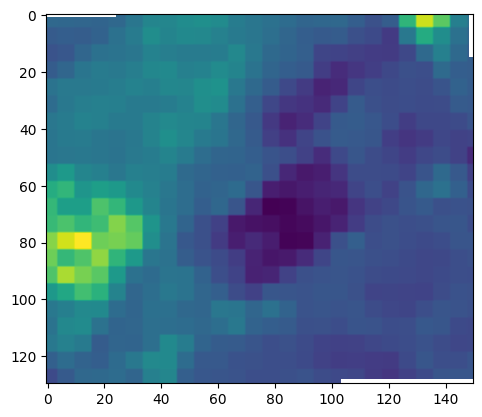

In [ ]:
band = ds.GetRasterBand(1)
array = band.ReadAsArray()
plt.figure()
plt.imshow(array)

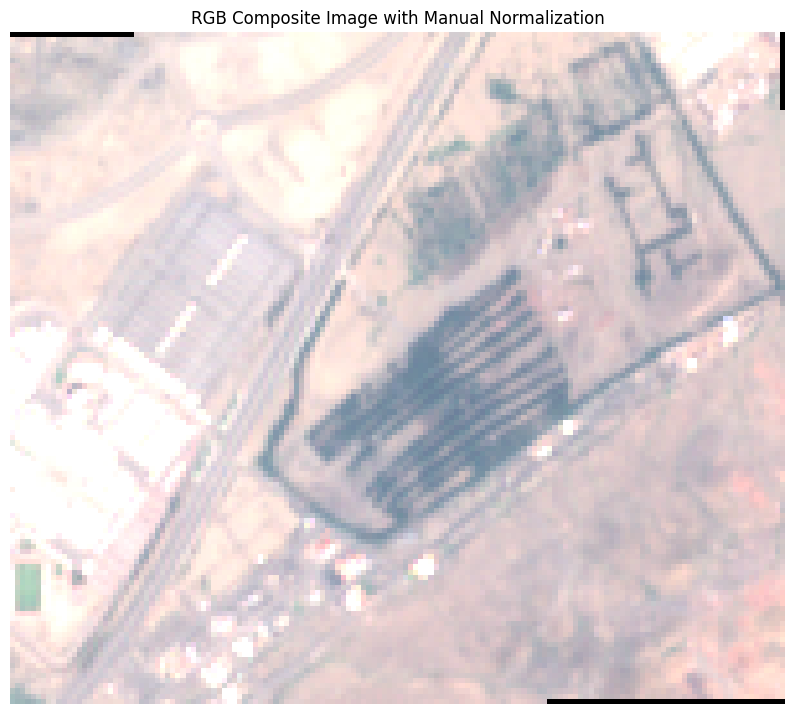

In [ ]:
# Function to normalize array based on a given min and max value for display
def manual_normalize(array, min_val, max_val):
    array = np.clip(array, min_val, max_val)  # Clip to the specified range
    return (array - min_val) / (max_val - min_val)  # Normalize to [0, 1]

# Get bands for Red, Green, and Blue
band_red = ds.GetRasterBand(4).ReadAsArray()
band_green = ds.GetRasterBand(3).ReadAsArray()
band_blue = ds.GetRasterBand(2).ReadAsArray()

# Manually set the min and max values for display range based on histogram inspection or domain knowledge
min_display_val = 1000  # Example value, adjust based on your data
max_display_val = 3000  # Example value, adjust based on your data

# Normalize bands with the manually set display range
n_band_red = manual_normalize(band_red, min_display_val, max_display_val)
n_band_green = manual_normalize(band_green, min_display_val, max_display_val)
n_band_blue = manual_normalize(band_blue, min_display_val, max_display_val)

# Stack bands
rgb = np.dstack((n_band_red, n_band_green, n_band_blue))

# Plotting
plt.figure(figsize=(10, 10))
plt.imshow(rgb)
plt.title('RGB Composite Image with Manual Normalization')
plt.axis('off')  # Turn off the axis
plt.show()

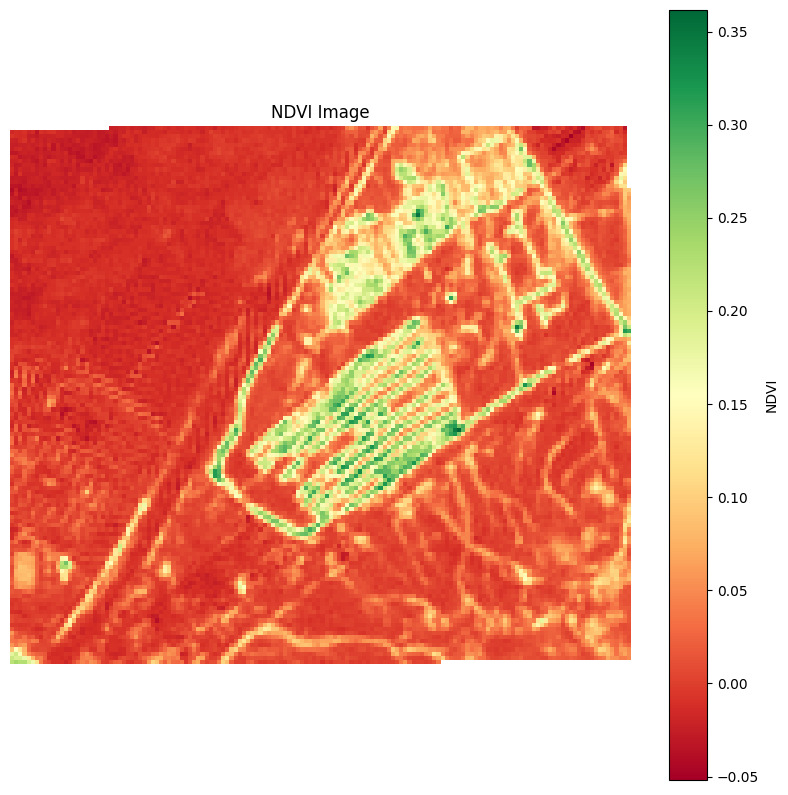

In [ ]:
def read_band(band_number):
    band = ds.GetRasterBand(band_number).ReadAsArray().astype(np.float32)
    return band

# Read the Red and NIR bands from the dataset
red = read_band(4)  # Assuming Band 4 is Red
nir = read_band(8)  # Assuming Band 8 is NIR

# Calculate NDVI
ndvi = (nir - red) / (nir + red)


# Plot NDVI
plt.figure(figsize=(10, 10))
plt.imshow(ndvi, cmap='RdYlGn')
plt.colorbar(label='NDVI')
plt.title('NDVI Image')
plt.axis('off')  # Turn off the axis
plt.show()